In [1]:
import numpy as np
from cytoolz.dicttoolz import _iter_mapping
from matplotlib import pyplot as plt
from czifile import czifile
import os

C:\Users\gimesia\.anaconda3\envs\ZF\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.1
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
directory = os.getcwd()
directory_ = f'{directory}\AB 15Gy 3.nap'
files = os.listdir(directory_)
print(directory_)
images_15Gy_title = files.copy()
images_15Gy = []

for file in files:
    images_15Gy.append(czifile.imread(f'{directory_}\\{file}')[0, :, :, 0])
print(len(images_15Gy))
images_15Gy = np.asarray(images_15Gy)

directory = os.getcwd()
directory_ = f'{directory}\AB  KO 3.nap'
files = os.listdir(directory_)

print(directory_)
images_KO_title = files.copy()
images_KO = []

for file in files:
    images_KO.append(czifile.imread(f'{directory_}\\{file}')[0, :, :, 0])
images_KO = np.asarray(images_KO)
print(len(images_KO))

C:\Users\gimesia\Documents\PROJEKT\zf_conda\__jupyter__\AB 15Gy 3.nap
87
C:\Users\gimesia\Documents\PROJEKT\zf_conda\__jupyter__\AB  KO 3.nap
93


IndexError: index 25 is out of bounds for axis 0 with size 25

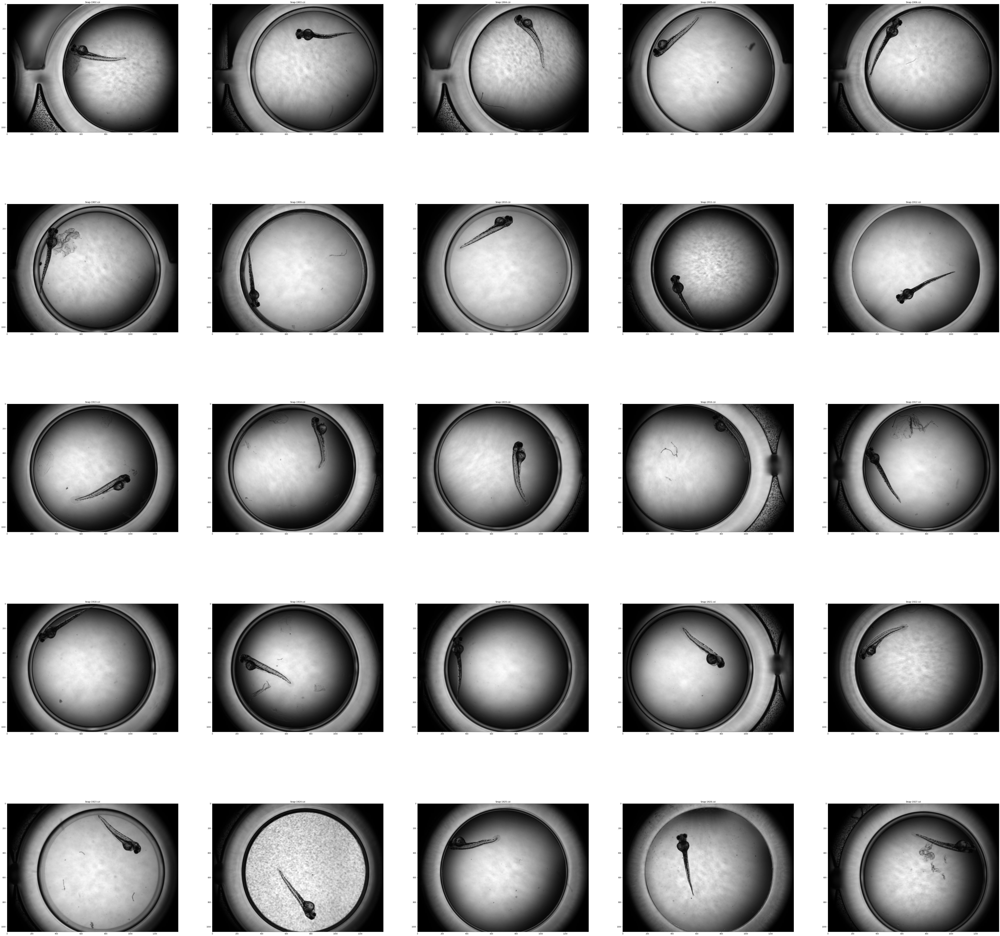

In [5]:
fig, ax = plt.subplots(nrows=5, ncols=5, figsize=(100, 100))
ax = ax.ravel()

for i, image in enumerate(images_15Gy[:50:1]):
    ax[i].imshow(image, 'gray')
    ax[i].set_title(images_15Gy_title[i])

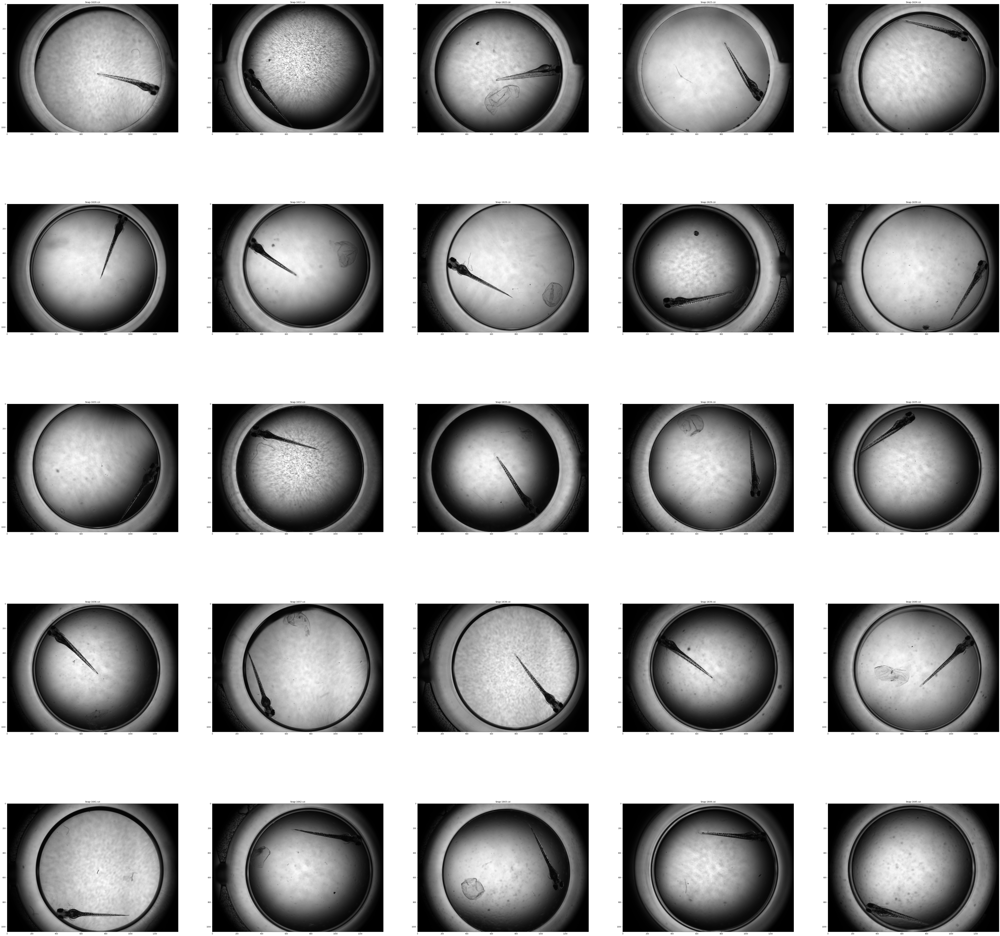

In [7]:
fig, ax = plt.subplots(nrows=5, ncols=5, figsize=(100, 100))
ax = ax.ravel()

for i, image in enumerate(images_KO[:50:2]):
    ax[i].imshow(image, 'gray')
    ax[i].set_title(images_KO_title[i])

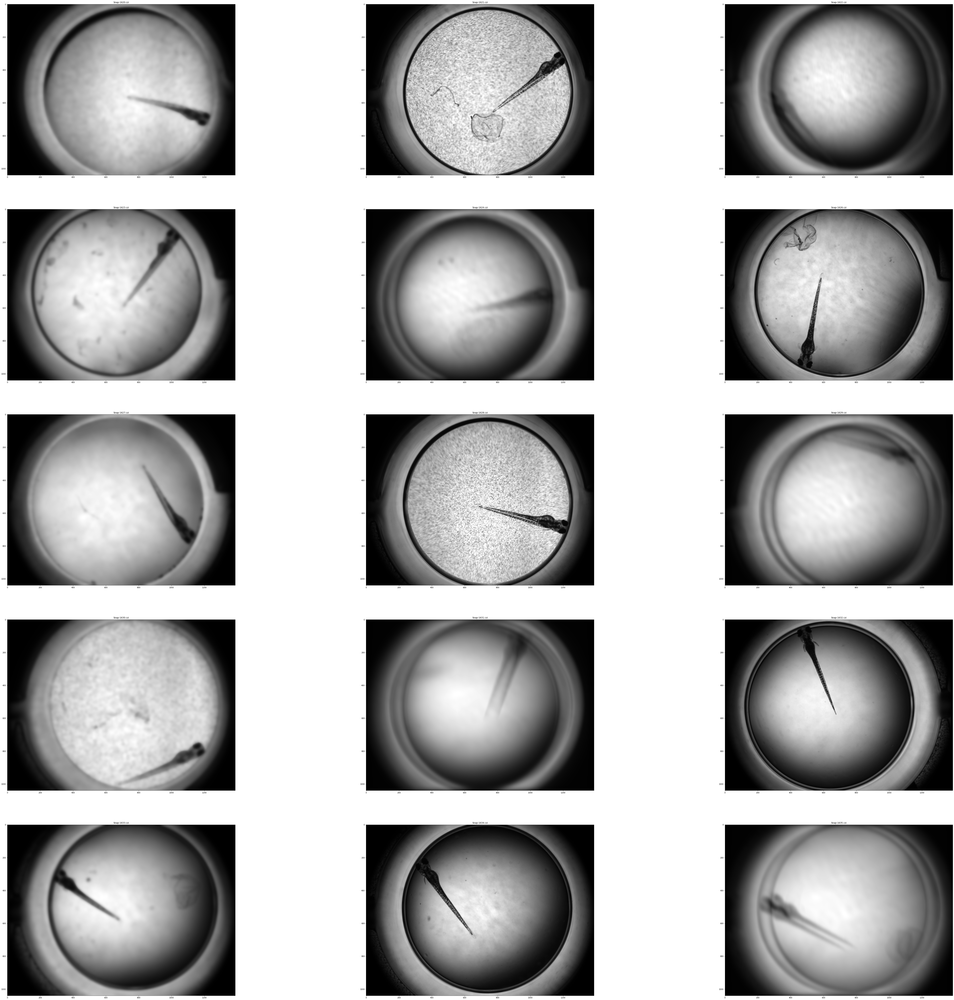

In [8]:
from skimage.restoration import denoise_tv_chambolle, denoise_bilateral, denoise_wavelet

fig, ax = plt.subplots(nrows=5, ncols=3, figsize=(100, 100))
ax = ax.ravel()

for i, image in enumerate(images_KO[:15]):
    im = (image.copy())

    if i % 3 == 0:
        im = (denoise_tv_chambolle(im, weight=0.2))
    elif i % 2 == 0:
        im = (denoise_bilateral(im, sigma_color=0.1, sigma_spatial=15))
    else:
        im = (denoise_wavelet(im))

    ax[i].imshow(im, 'gray')
    ax[i].set_title(images_KO_title[i])

In [ ]:
from skimage.morphology import remove_small_objects
from skimage.exposure import equalize_hist
from skimage.filters._unsharp_mask import unsharp_mask
from skimage.filters._gaussian import difference_of_gaussians

i = images_KO_title.index('Snap-1694.czi')
filtered_image = difference_of_gaussians(unsharp_mask(images_KO[i], amount=20, radius=2), 2, 5)

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(100, 100))
ax = ax.ravel()
ax[0].imshow(filtered_image, 'binary')
ax[1].imshow(remove_small_objects(equalize_hist() < 0.15), 'binary')